In [2]:
import numpy as np
from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms as T

img = Image.open('./images/ZX1000RR.jpg')

# Read Original image size  
width, height = img.size


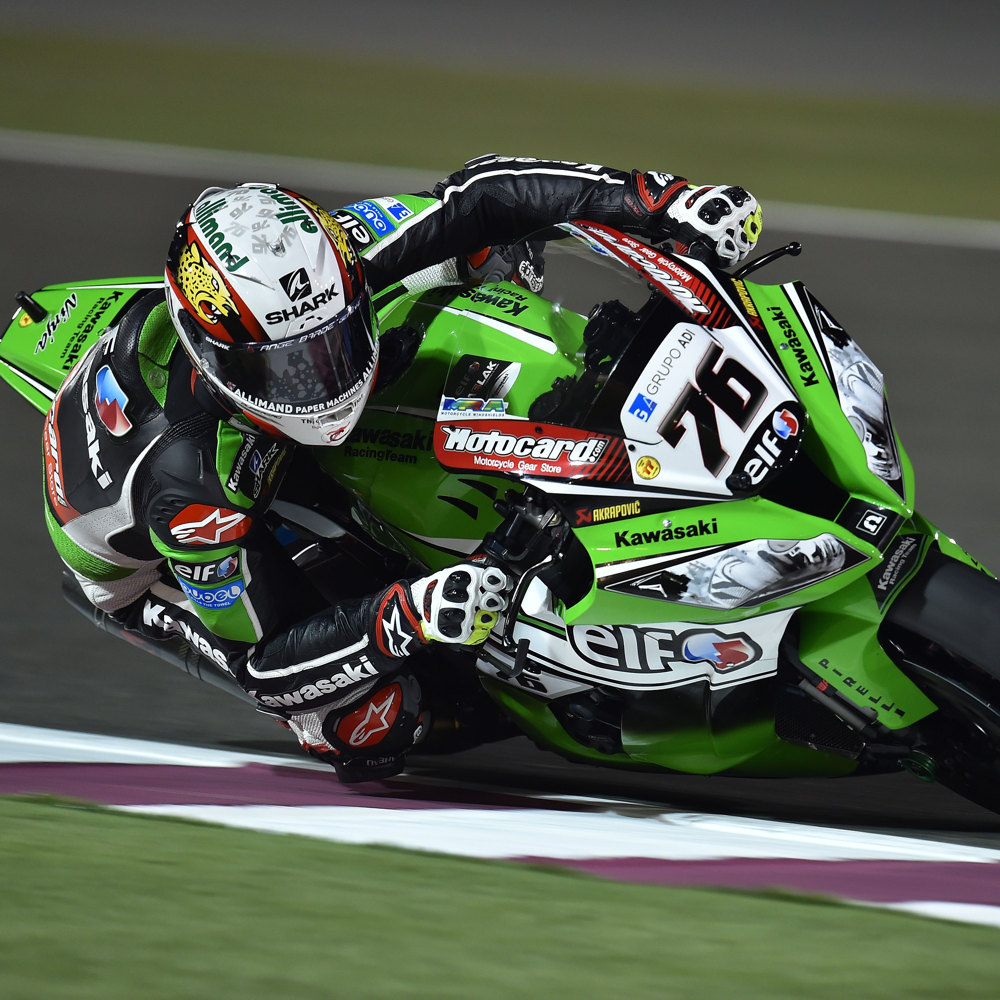

In [3]:
# Set requirement Image Corp boundary
if width < height:
    sqrbound = width
else:
    sqrbound = height
# Setting the points for cropped image
left = 500
top = 0
right = sqrbound + left
bottom = sqrbound
imgcrop = img.crop((left, top, right, bottom))
imgcrop

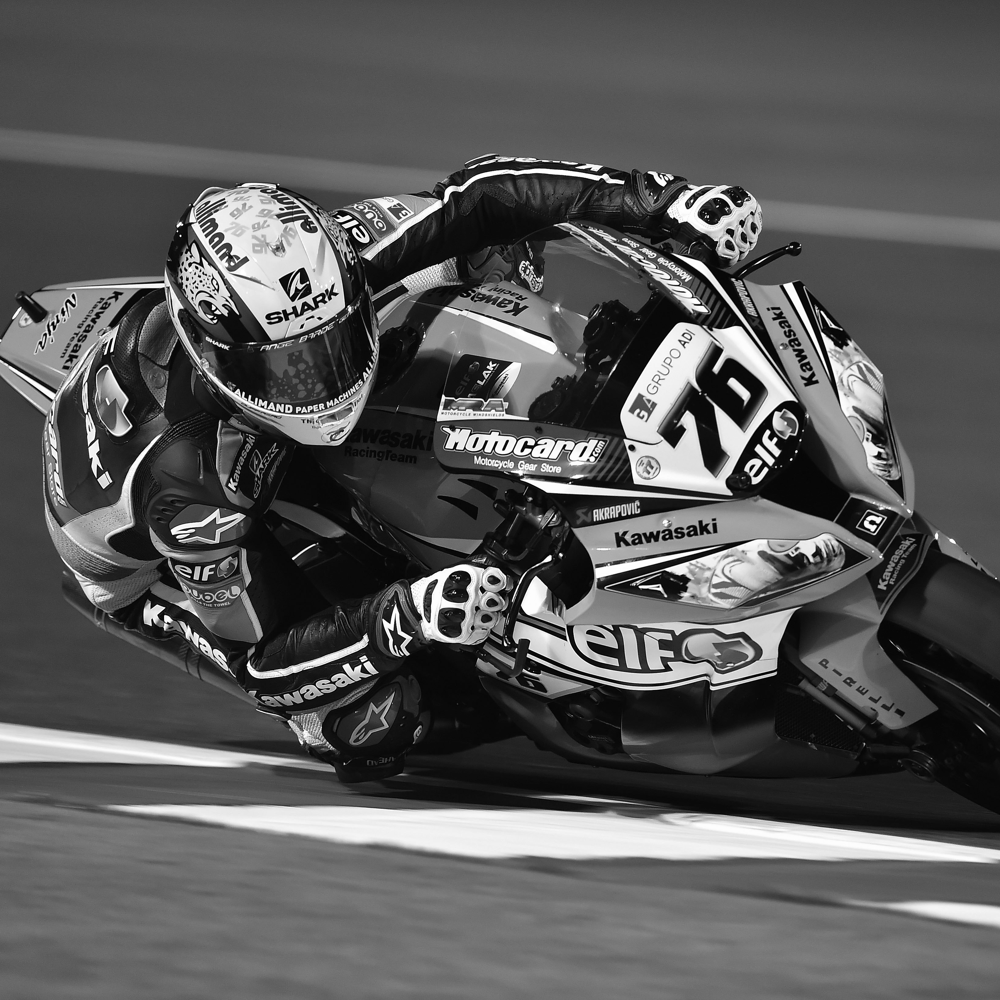

In [4]:
# Image grayscaling
imgGray = imgcrop.convert('L')
imgGray

In [5]:
# Resize image
newSize = (64, 64)
newImg = imgGray.resize(newSize)
newImg.save('./images/ZX1000RR_resized.jpg')
newImg_arr = np.array(newImg)
newImg_arr32 = newImg_arr.astype(np.float32)
inputImage = torch.tensor(newImg_arr32)
inputImage

tensor([[ 73.,  73.,  73.,  ...,  64.,  64.,  63.],
        [ 73.,  73.,  73.,  ...,  68.,  68.,  67.],
        [ 69.,  70.,  71.,  ...,  73.,  72.,  72.],
        ...,
        [ 94.,  96.,  95.,  ..., 113., 114., 112.],
        [100.,  99.,  98.,  ..., 103., 103., 102.],
        [101., 100., 102.,  ...,  92.,  95.,  93.]])

In [6]:
# Init Convolution parameters
kernel = torch.tensor([-0.0625, -0.125, -0.0625, -0.25, 1., -0.25, -
                      0.0625, -0.125, -0.0625]).reshape(3, 3).unsqueeze(0).unsqueeze(0)

bias = torch.tensor(-0.75).unsqueeze(0)
input = inputImage.unsqueeze(0).unsqueeze(0)
print("\n kernel: \n", kernel)
print("\n bias: \n", bias)
print("\n input Image \n", input)


 kernel: 
 tensor([[[[-0.0625, -0.1250, -0.0625],
          [-0.2500,  1.0000, -0.2500],
          [-0.0625, -0.1250, -0.0625]]]])

 bias: 
 tensor([-0.7500])

 input Image 
 tensor([[[[ 73.,  73.,  73.,  ...,  64.,  64.,  63.],
          [ 73.,  73.,  73.,  ...,  68.,  68.,  67.],
          [ 69.,  70.,  71.,  ...,  73.,  72.,  72.],
          ...,
          [ 94.,  96.,  95.,  ..., 113., 114., 112.],
          [100.,  99.,  98.,  ..., 103., 103., 102.],
          [101., 100., 102.,  ...,  92.,  95.,  93.]]]])


In [7]:
# Padding
m = nn.ReplicationPad2d(2)
pad_data = m(input)
pad_data

tensor([[[[ 73.,  73.,  73.,  ...,  63.,  63.,  63.],
          [ 73.,  73.,  73.,  ...,  63.,  63.,  63.],
          [ 73.,  73.,  73.,  ...,  63.,  63.,  63.],
          ...,
          [101., 101., 101.,  ...,  93.,  93.,  93.],
          [101., 101., 101.,  ...,  93.,  93.,  93.],
          [101., 101., 101.,  ...,  93.,  93.,  93.]]]])

In [8]:
# Convolution
res = F.conv2d(pad_data, kernel, bias=bias, stride=1, padding=0, dilation=2)
print("\nConvolution result:\n", res)
relu_data = F.relu(res)
print("\nRelu result: \n",  relu_data)


Convolution result:
 tensor([[[[ 0.1250, -0.0625, -0.5625,  ..., -3.3750, -2.8750, -3.3750],
          [ 0.1250, -0.3125, -0.7500,  ..., -2.3125, -2.0625, -2.6250],
          [-3.3125, -2.5625, -2.0000,  ..., -0.7500, -1.2500, -0.6875],
          ...,
          [-6.5000, -3.9375, -5.2500,  ...,  4.8750,  4.4375,  0.3125],
          [ 0.1875, -0.6875, -1.7500,  ...,  0.4375,  1.3750,  1.2500],
          [ 0.6250, -1.0000,  0.2500,  ..., -6.8125, -3.3750, -5.2500]]]])

Relu result: 
 tensor([[[[0.1250, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.1250, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 4.8750, 4.4375, 0.3125],
          [0.1875, 0.0000, 0.0000,  ..., 0.4375, 1.3750, 1.2500],
          [0.6250, 0.0000, 0.2500,  ..., 0.0000, 0.0000, 0.0000]]]])


In [9]:
# MaxPooling
maxpoolRes = F.max_pool2d(relu_data, 2, stride=2, padding=0)
maxpoolRes

tensor([[[[ 0.1250,  0.0000,  0.5000,  ...,  0.0000,  0.0000,  0.0000],
          [ 0.0000,  0.0000,  0.0000,  ...,  0.3125,  0.1875,  0.0000],
          [ 0.1875,  0.9375,  0.0000,  ...,  2.5000,  1.6250,  1.6875],
          ...,
          [ 6.1875,  4.4375,  4.3750,  ..., 47.1875, 66.6875, 68.4375],
          [ 0.0000,  0.0000,  1.5625,  ...,  4.6875,  4.8750,  4.4375],
          [ 0.6250,  1.8750,  2.6250,  ...,  0.0000,  0.4375,  1.3750]]]])

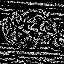

In [10]:
# Save the Image after convolution and maxpooling 
transform = T.ToPILImage()
l0_result = transform(relu_data.squeeze().squeeze())
l0_result.save('./images/ZX1000RR_l0.jpg')
l1_result = transform(maxpoolRes.squeeze().squeeze())
l1_result.save('./images/ZX1000RR_l1.jpg')
l0_result

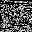

In [11]:
l1_result

In [12]:
from fxpmath import Fxp
# Generate img.dat
ImagGray_flatten = newImg_arr32.flatten()
ImgData = Fxp(ImagGray_flatten, dtype='fxp-s13/4')
print(ImagGray_flatten)
print(ImgData.bin())
with open("./data/img.dat", 'w') as f:
    for row in ImgData:    
            f.write(str(row.bin()) + "      // data: " + str(row) + "\n")

[73. 73. 73. ... 92. 95. 93.]
['0010010010000', '0010010010000', '0010010010000', '0010010010000', '0010010100000', '0010010100000', '0010010110000', '0010010110000', '0010010110000', '0010011000000', '0010011000000', '0010011000000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011100000', '0010011010000', '0010011100000', '0010011100000', '0010011100000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011010000', '0010011000000', '0010011000000', '0010011000000', '0010011000000', '0010011000000', '0010010110000', '0010010110000', '0010010100000', '0010010100000', '0010010100000', '0010010010000', '0010010010000', '0010010010000', '0010010010000', '0010010000000', '0010010000000', '0010001110000', '0010001110000', '0010001100000', '0010001100000', '0010001010000', '0010001010000', '0010001010000', '0010001000000', '0010000110000', '0010000110000', 

In [13]:
l0_data_flatten = relu_data.numpy().flatten()
l0Data = Fxp(l0_data_flatten, dtype='fxp-s13/4')
print(l0_data_flatten)
print(l0Data.bin())
with open("./data/layer0_golden.dat", 'w') as f:
    for row in l0Data:    
            f.write(str(row.bin()) + "      // data: " + str(row) + "\n")

[0.125 0.    0.    ... 0.    0.    0.   ]
['0000000000010', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000

In [14]:
l1_data_flatten = maxpoolRes.numpy().flatten()
l1_data_flatten_ceil = np.ceil(l1_data_flatten)
l1Data = Fxp(l1_data_flatten_ceil, dtype='fxp-s13/4')
print(l1_data_flatten_ceil)
print(l1Data.bin())
with open("./data/layer1_golden.dat", 'w') as f:
    for row in l1Data:    
            f.write(str(row.bin()) + "      // data: " + str(row) + "\n")

[1. 0. 1. ... 0. 1. 2.]
['0000000010000', '0000000000000', '0000000010000', '0000000010000', '0000000100000', '0000000010000', '0000000010000', '0000000010000', '0000000010000', '0000000010000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000000000', '0000000010000', '0000000100000', '0000000100000', '0000000010000', '0000000100000', '0000000100000', '0000000110000', '0000000100000', '0000000100000', '0000000110000', '0000001000000', '0000000110000', '0000000110000', '0000000100000', '0000000100000', '0000000100000', '0000000100000', '0000000010000', '0000000010000', '0000000010000', '0000000010000', '00000